No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
8.12
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
9.57
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
10.1
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
10.2
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
10.1
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lane detected
No lan

KeyboardInterrupt: 

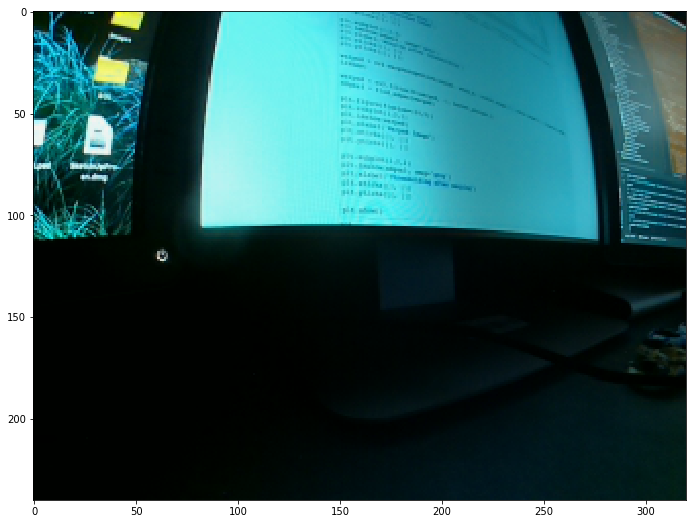

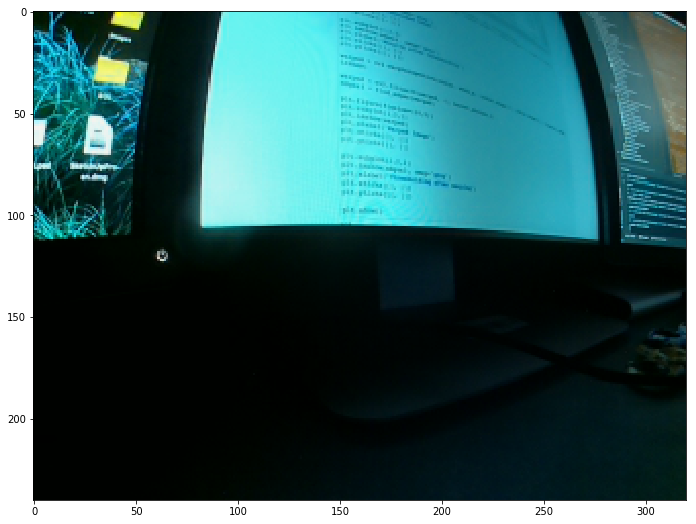

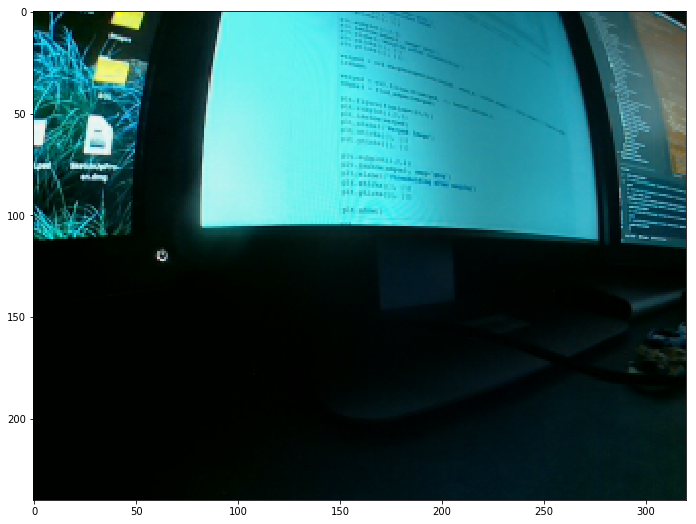

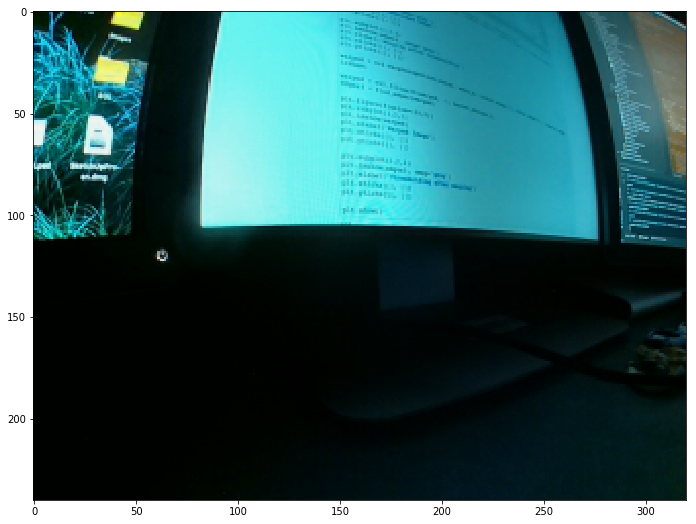

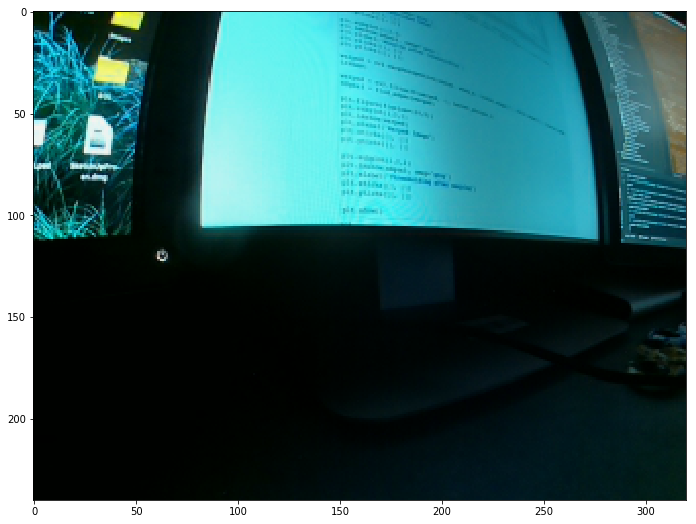

...

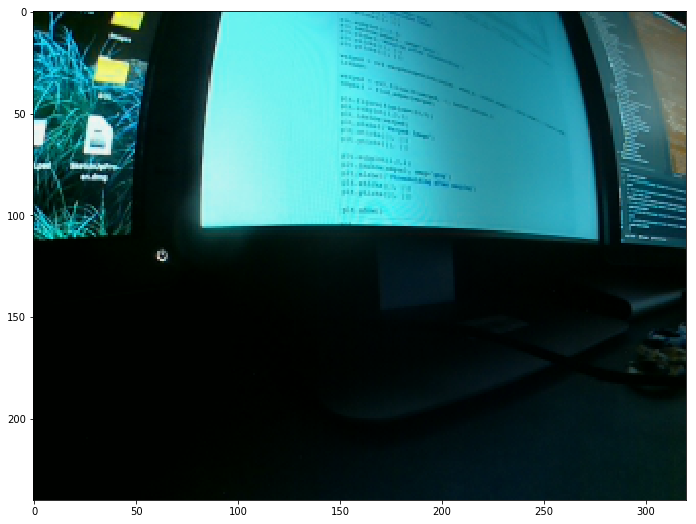

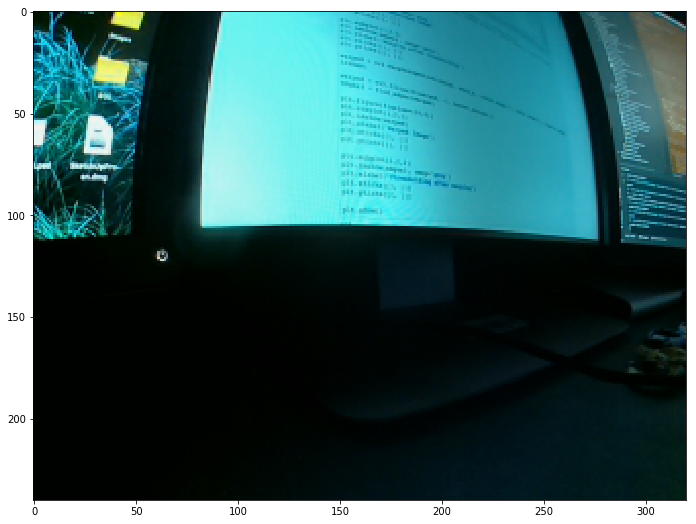

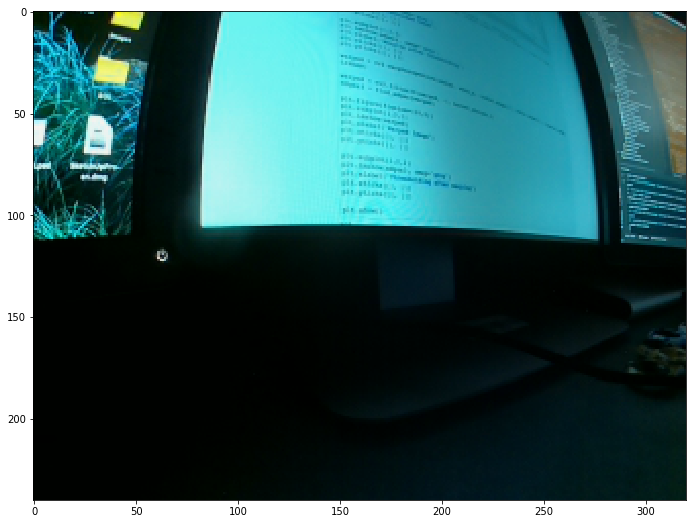

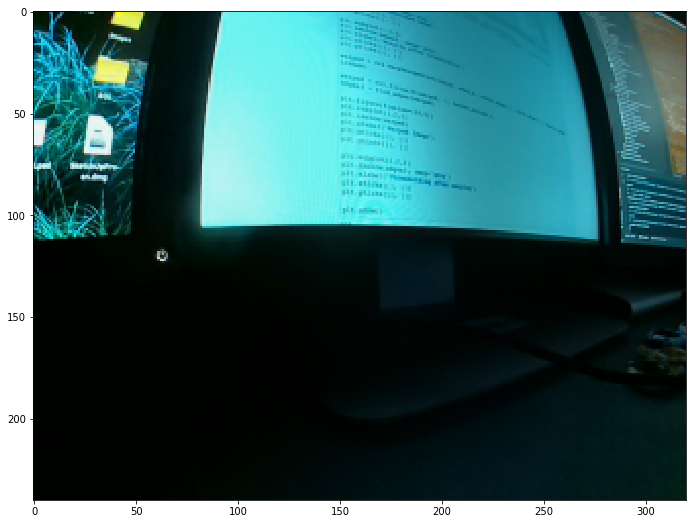

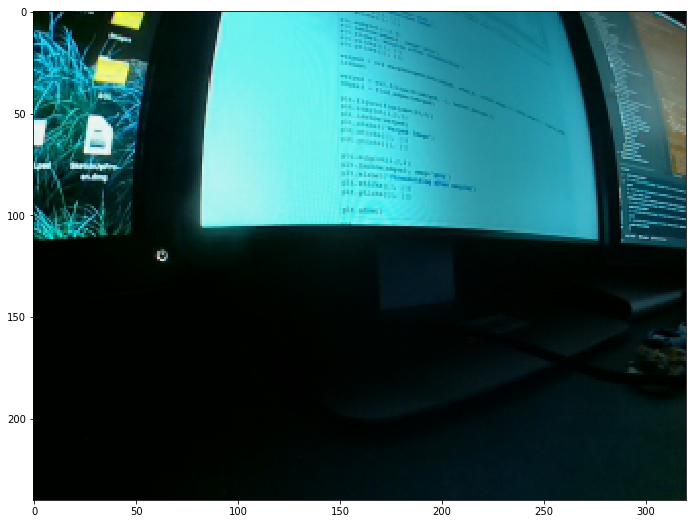

In [3]:
import http.client
import requests
import cv2
import numpy as np
import io
from PIL import Image
import time
import test
import os
import sys
sys.path.append("..")
from pynput.keyboard import Listener, Controller
from streamer.object_detection import detection

from streamer.object_detection.utils import visualization_utils as vis_util
from streamer.object_detection.utils import label_map_util


HOST = '192.168.5.1'
PORT = '8000'

BASE_URL = 'http://' + HOST + ':' + PORT + '/'

PATH_TO_LABELS  = os.path.join('object_detection/data', 'mscoco_label_map.pbtxt')
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)


class QueryImage:

    def __init__(self, host, port=8080, argv='/?action=snapshot'):
        self.host = host
        self.port = port
        self.argv = argv

    def queryImage(self):
        http_data = http.client.HTTPConnection(self.host, self.port)
        http_data.putrequest('GET', self.argv)
        http_data.putheader('Host', self.host)
        http_data.putheader('User-agent', 'python-http.client')
        http_data.putheader('Content-type', 'image/jpeg')
        http_data.endheaders()
        returnmsg = http_data.getresponse()
        returnmsg = returnmsg.read()
        returnmsg = io.BytesIO(returnmsg)
        returnmsg = Image.open(returnmsg)
        img = np.array(returnmsg)

        return img


def __request__(url, times=10):
    for x in range(times):
        try:
            requests.get(url)
            return 0
        except:
            return
    return -1


def run_action(cmd):
    url = BASE_URL + 'run/?action=' + cmd
    __request__(url)


def run_speed(speed):
    url = BASE_URL + 'run/?speed=' + speed
    __request__(url)


def on_press(key):
    if '{0}'.format(key) == "'w'":
        run_action('forward')
    if '{0}'.format(key) == "'a'":
        run_action('fwleft')
    if '{0}'.format(key) == "'s'":
        run_action('backward')
    if '{0}'.format(key) == "'d'":
        run_action('fwright')


def on_release(key):
    if '{0}'.format(key) == "'w'":
        run_action('stop')
    if '{0}'.format(key) == "'a'":
        run_action('fwstraight')
    if '{0}'.format(key) == "'s'":
        run_action('stop')
    if '{0}'.format(key) == "'d'":
        run_action('fwstraight')


def connection_ok():
    cmd = 'connection_test'
    url = BASE_URL + cmd

    try:
        r = requests.get(url)
        if r.text == 'OK':
            return True
    except:
        return False


if connection_ok():
    run_action('fwready')
    run_action('bwready')
    queryImage = QueryImage(HOST)
else:
    exit()


# with keyboard.Listener(on_press=on_press, on_release=on_release) as listener:
#     listener.join()
keyboard = Controller()
Listener(on_press=on_press, on_release=on_release).start()

sum = 0
count = 0

# cap = cv2.VideoCapture("./project_video.mp4")
cv2.namedWindow('Stream', cv2.WINDOW_NORMAL)
cv2.resizeWindow('Stream', 900, 720)

last_time = time.time()
while(True):
    image = queryImage.queryImage()
    try:
        # image = np.array(Image.open('test_images/test1.jpg'))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = test.process_img(image)
    except ValueError:
        print("No lane detected")
        pass
    # cv2.imshow('Stream', cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    cv2.imshow('Stream', image)

    #image_np_expanded = np.expand_dims(image, axis=0)

    # image = cv2.resize(image, (160, 120))

    # output_dict = detection.run_inference_for_single_image(image)
    #
    # vis_util.visualize_boxes_and_labels_on_image_array(
    #     image,
    #     output_dict['detection_boxes'],
    #     output_dict['detection_classes'],
    #     output_dict['detection_scores'],
    #     category_index,
    #     instance_masks=output_dict.get('detection_masks'),
    #     use_normalized_coordinates=True,
    #     line_thickness=1
    # )

    cv2.imshow('Stream', image)
    # cv2.imshow('Stream', cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    # if cap.grab():
    #     flag, frame = cap.retrieve()
    #     if not flag:
    #         continue
    #     else:
    #         image = np.array(frame)
    #         image = test.process_img(image)
    #         cv2.imshow('test', image)

    diff = time.time() - last_time
    fps = 1 / diff
    sum += fps
    count += 1
    if count == 10:
        print('{0:.3g}'.format(sum / count))
        sum = 0
        count = 0
    last_time = time.time()
    if cv2.waitKey(25) & 0xFF == ord('q'):
        cv2.destroyAllWindows()
        break


# PATH = 'test_images'
# TEST_IMAGES = [os.path.join(PATH, 'test{}.jpg'.format(i)) for i in range(1, 9)]
#
#
# #start_time = time.time()
# for image_path in TEST_IMAGES:
#     #plt.figure(figsize=(16, 9))
#     image = np.array(Im.open(image_path))
#     new_image = process_img(image)
#     #plt.imshow(new_image)
#     new_image = Im.fromarray(new_image, 'RGB')
#     new_image.show()
#     #cv2.imshow('window', new_image)
#     #print(time.time() - start_time)
#     #start_time = time.time()
